# Práctica 4


## Introducción

La ingeniería de IA es una disciplina emergente que busca desarrollar herramientas y sistemas para aplicar la inteligencia artificial de manera efectiva en contextos reales. Esta disciplina se centra en resolver problemas clave sobre cómo la IA puede ayudar a los humanos a lograr resultados específicos, los límites actuales de los sistemas de IA, y cómo se pueden mantener los estándares éticos durante su implementación.

A pesar de los avances tecnológicos y la disponibilidad de grandes volúmenes de datos, muchas capacidades de IA aún se limitan a entornos controlados y enfrentan desafíos para su aplicación práctica en condiciones reales y dinámicas. La ingeniería de IA propone un marco para diseñar sistemas de IA que operen eficazmente en entornos complejos y cambiantes, garantizando que sean éticos y confiables, y que satisfagan las necesidades humanas en diversas situaciones operacionales.

## Estado del arte

La integración de la inteligencia artificial (IA) con sensores está transformando numerosas industrias al mejorar la precisión y eficiencia de las tecnologías de detección. Este campo en rápida evolución ha encontrado aplicaciones significativas en mantenimiento industrial, sostenibilidad, hogares inteligentes, conducción autónoma y el cuidado de la salud.

En el mantenimiento industrial, por ejemplo, la combinación de IA con sensores como cámaras térmicas y ultrasonidos permite prever y prevenir fallos en las máquinas. Esto optimiza los procesos de mantenimiento y reduce los tiempos de inactividad, clave para la eficiencia operativa. En términos de sostenibilidad, la IA analiza los patrones de datos recogidos por los sensores para identificar y mitigar errores y desperdicios, lo que contribuye a una gestión más eficiente de los recursos y fomenta prácticas más sostenibles.

En el ámbito de los hogares inteligentes, sensores de movimiento, CO2, humedad y temperatura utilizan la IA para ajustar dispositivos inteligentes, mejorando así el confort y la eficiencia energética del hogar. Para la conducción autónoma, la IA procesa datos de cámaras, radar y LiDAR, permitiendo que los vehículos naveguen sin intervención humana. En el sector salud, la IA interpreta datos de sensores médicos, como resonancias magnéticas y ultrasonidos, para diagnosticar condiciones de salud de manera rápida y precisa.

Los beneficios de combinar la IA con sensores son notables y van desde la mejora de la precisión en el procesamiento de datos hasta la ampliación de las aplicaciones de los sensores en campos que anteriormente no eran posibles. La automatización de tareas que tradicionalmente realizan humanos no solo ahorra costos, sino que también mejora la eficiencia general. Además, la capacidad de generar nuevas oportunidades y soluciones que antes eran inimaginables es uno de los aspectos más emocionantes de esta tecnología.

Un ejemplo específico de esta aplicación es la prevención de incendios en la gestión de residuos, donde cámaras termográficas activadas por IA determinan cuándo un punto caliente justifica una alarma, diferenciando entre peligros reales y falsos positivos, como el calor de un vehículo que pasa. Otro ejemplo es en la visión de máquina utilizada en la automatización industrial para la inspección y el control de calidad, donde la IA ayuda a optimizar procesos y a monitorear la seguridad a través de la interpretación de información visual.

En resumen, la combinación de IA con tecnología sensorial está abriendo nuevas vías para optimizaciones significativas en varios sectores, prometiendo revolucionar la forma en que interactuamos con la tecnología tanto en nuestra vida diaria como profesional. Conforme avanzan las tecnologías de IA, seguiremos viendo formas innovadoras y mejoradas de combinar IA y sensores para mejorar el mundo a nuestro alrededor.

In [4]:
import pandas as pd
import warnings
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
import matplotlib.pyplot as plt
import seaborn as sns
!pip install river
import river

## Exploración de datos

### Cargando los datos y obteniendo información


In [5]:
df = pd.read_csv('sensor.csv')

df.shape
df.info()
df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220320 entries, 0 to 220319
Data columns (total 55 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Unnamed: 0      220320 non-null  int64  
 1   timestamp       220320 non-null  object 
 2   sensor_00       210112 non-null  float64
 3   sensor_01       219951 non-null  float64
 4   sensor_02       220301 non-null  float64
 5   sensor_03       220301 non-null  float64
 6   sensor_04       220301 non-null  float64
 7   sensor_05       220301 non-null  float64
 8   sensor_06       215522 non-null  float64
 9   sensor_07       214869 non-null  float64
 10  sensor_08       215213 non-null  float64
 11  sensor_09       215725 non-null  float64
 12  sensor_10       220301 non-null  float64
 13  sensor_11       220301 non-null  float64
 14  sensor_12       220301 non-null  float64
 15  sensor_13       220301 non-null  float64
 16  sensor_14       220299 non-null  float64
 17  sensor_15 

,Unnamed: 0,timestamp,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
0,0,2018-04-01 00:00:00,2.465394,47.09201,53.2118,46.310760,634.3750,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
1,1,2018-04-01 00:01:00,2.465394,47.09201,53.2118,46.310760,634.3750,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2,2,2018-04-01 00:02:00,2.444734,47.35243,53.2118,46.397570,638.8889,73.54598,13.32465,16.03733,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL
3,3,2018-04-01 00:03:00,2.460474,47.09201,53.1684,46.397568,628.1250,76.98898,13.31742,16.24711,...,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL
4,4,2018-04-01 00:04:00,2.445718,47.13541,53.2118,46.397568,636.4583,76.58897,13.35359,16.21094,...,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL


In [6]:

def calc_percent_NAs(df):
    nans = pd.DataFrame(df.isnull().sum().sort_values(ascending=False)/len(df), columns=['percent'])
    idx = nans['percent'] > 0
    return nans[idx]



calc_percent_NAs(df).head(10)

,percent
sensor_15,1.000000
sensor_50,0.349569
sensor_51,0.069821
sensor_00,0.046333
sensor_07,0.024741
sensor_08,0.023180
sensor_06,0.021777
sensor_09,0.020856
sensor_01,0.001675
sensor_30,0.001185


### Limpieza de datos y preprocesamiento antes de realizar el EDA

Se decide eliminar los sensores sin datos y rellenar aquellos que sí que los tienen.

In [7]:
df = df.drop_duplicates()
df = df.drop(columns='Unnamed: 0')
df = df.drop(columns=['sensor_15'], errors='ignore')
warnings.filterwarnings("ignore")
df['date'] = pd.to_datetime(df['timestamp'])
df = df.drop(columns='timestamp')

Se manejan los valores faltantes, imputar con la media para este caso

In [8]:
# Esto es una manera de preparar los datos
numeric_columns = df.select_dtypes(include=[np.number]).columns
for column in numeric_columns:
    df[column].fillna(df[column].mean(), inplace=True)

Se usa a continuación el módulo de preprocesamiento de sklearn para transformar los datos. Utilizamos la lista 'cols' como nombre de las listas a escalar. El escalador Min-Max escala cada característica a un rango dado. Se realiza este escalado porque el análisis de componentes principales o PCA es especialmente sensible a la escala de las características.


In [9]:
from sklearn import preprocessing
cols = ['sensor_00', 'sensor_01', 'sensor_02', 'sensor_03', 'sensor_04',
       'sensor_05', 'sensor_06', 'sensor_07', 'sensor_08', 'sensor_09',
       'sensor_10', 'sensor_11', 'sensor_12', 'sensor_13', 'sensor_14',
       'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20',
       'sensor_21', 'sensor_22', 'sensor_23', 'sensor_24', 'sensor_25',
       'sensor_26', 'sensor_27', 'sensor_28', 'sensor_29', 'sensor_30',
       'sensor_31', 'sensor_32', 'sensor_33', 'sensor_34', 'sensor_35',
       'sensor_36', 'sensor_37', 'sensor_38', 'sensor_39', 'sensor_40',
       'sensor_41', 'sensor_42', 'sensor_43', 'sensor_44', 'sensor_45',
       'sensor_46', 'sensor_47', 'sensor_48', 'sensor_49', 'sensor_50',
       'sensor_51']
x = df[cols]
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
scaled = pd.DataFrame(x_scaled, columns=cols)
add = df.drop(cols, axis=1)
df_scaled = pd.concat([scaled, add], axis=1)
df_scaled.columns

Index(['sensor_00', 'sensor_01', 'sensor_02', 'sensor_03', 'sensor_04',
       'sensor_05', 'sensor_06', 'sensor_07', 'sensor_08', 'sensor_09',
       'sensor_10', 'sensor_11', 'sensor_12', 'sensor_13', 'sensor_14',
       'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20',
       'sensor_21', 'sensor_22', 'sensor_23', 'sensor_24', 'sensor_25',
       'sensor_26', 'sensor_27', 'sensor_28', 'sensor_29', 'sensor_30',
       'sensor_31', 'sensor_32', 'sensor_33', 'sensor_34', 'sensor_35',
       'sensor_36', 'sensor_37', 'sensor_38', 'sensor_39', 'sensor_40',
       'sensor_41', 'sensor_42', 'sensor_43', 'sensor_44', 'sensor_45',
       'sensor_46', 'sensor_47', 'sensor_48', 'sensor_49', 'sensor_50',
       'sensor_51', 'machine_status', 'date'],
      dtype='object')

### EDA cuantitativo

ATENCION: para hacer este EDA me estoy basando en https://github.com/bauyrjanj/Anomaly_Detection/blob/master/notebooks/Predict%20Pump%20Failure%20-%20Exploratory%20Data%20Analysis.ipynb


Vamos a ver los datos tanto del dataframe escalado como el original

In [10]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
sensor_00,220320.0,2.372221,0.0,2.419155,2.455556,2.499826,2.549016,0.402564
sensor_01,220320.0,47.591611,0.0,46.31076,48.133678,49.47916,56.72743,3.293904
sensor_02,220320.0,50.867392,33.15972,50.39062,51.6493,52.77777,56.03299,3.666662
sensor_03,220320.0,43.752481,31.64062,42.838539,44.227428,45.3125,48.22049,2.418782
sensor_04,220320.0,590.673936,2.798032,626.6204,632.638916,637.615723,800.0,144.017702
sensor_05,220320.0,73.396414,0.0,69.977213,75.576145,80.91177,99.99988,17.297501
sensor_06,220320.0,13.501537,0.014468,13.34635,13.62847,14.53993,22.25116,2.140046
sensor_07,220320.0,15.843152,0.0,15.85648,16.16753,16.42795,23.59664,2.173755
sensor_08,220320.0,15.200721,0.028935,15.18374,15.45139,15.69734,24.34896,2.013639
sensor_09,220320.0,14.79921,0.0,15.01013,15.08247,15.11863,25.0,2.070033


In [11]:
df_scaled.describe().T

,count,mean,min,25%,50%,75%,max,std
sensor_00,220320.0,0.930642,0.0,0.949054,0.963335,0.980702,1.0,0.157929
sensor_01,220320.0,0.838952,0.0,0.816373,0.848508,0.872226,1.0,0.058065
sensor_02,220320.0,0.774164,0.0,0.75332,0.808349,0.857685,1.0,0.160303
sensor_03,220320.0,0.730516,0.0,0.675392,0.759162,0.824607,1.0,0.145887
sensor_04,220320.0,0.737424,0.0,0.782515,0.790064,0.796307,1.0,0.180654
sensor_05,220320.0,0.733965,0.0,0.699773,0.755762,0.809119,1.0,0.172975
sensor_06,220320.0,0.606523,0.0,0.599544,0.612231,0.65322,1.0,0.096239
sensor_07,220320.0,0.671416,0.0,0.67198,0.685162,0.696199,1.0,0.092121
sensor_08,220320.0,0.623839,0.0,0.623141,0.634146,0.644259,1.0,0.082798
sensor_09,220320.0,0.591968,0.0,0.600405,0.603299,0.604745,1.0,0.082801


In [12]:
df_scaled['machine_status'].value_counts()

machine_status
NORMAL        205836
RECOVERING     14477
BROKEN             7
Name: count, dtype: int64

Se puede ver que hay un debalanceo de clases entre los distintos valores del dataset. Se podría considerar el combinar los datos con machine_status RECOVERING y BROKEN ya que ambos implicarían un estado no normal.



Se decide extraer a continuación las lecturas de sensores de los distintos tipos 'normal', 'broken' y 'recovering' y separarlas en diferentes dataframes para su posterior evaluación y visualización.

In [13]:
normal = df_scaled[df_scaled['machine_status']=='NORMAL']
broken = df_scaled[df_scaled['machine_status']=='BROKEN']
recovering = df_scaled[df_scaled['machine_status']=='RECOVERING']

normal.set_index('date')
broken.set_index('date')
recovering.set_index('date')

numeric_normal = normal.select_dtypes(include=[np.number])
numeric_broken = broken.select_dtypes(include=[np.number])
numeric_recovering = recovering.select_dtypes(include=[np.number])


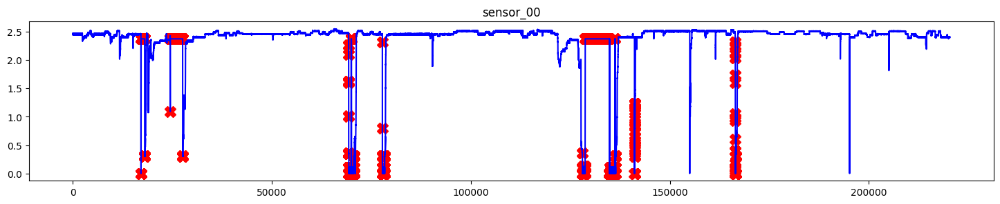

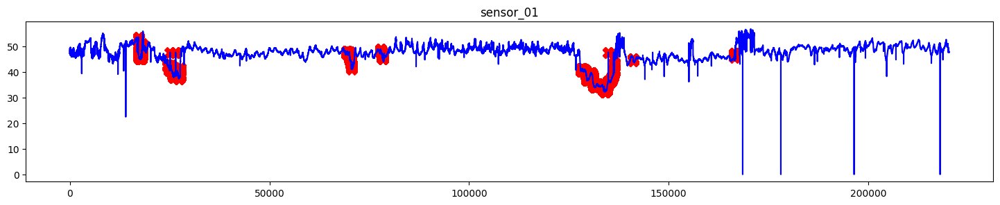

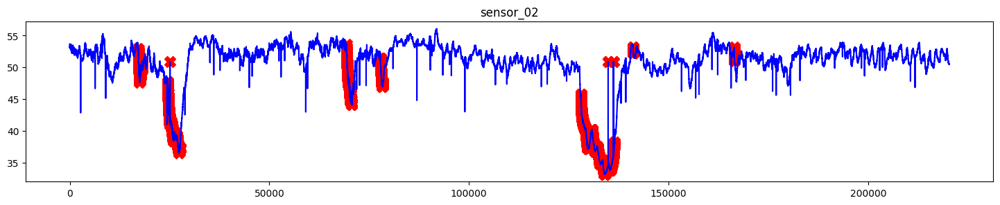

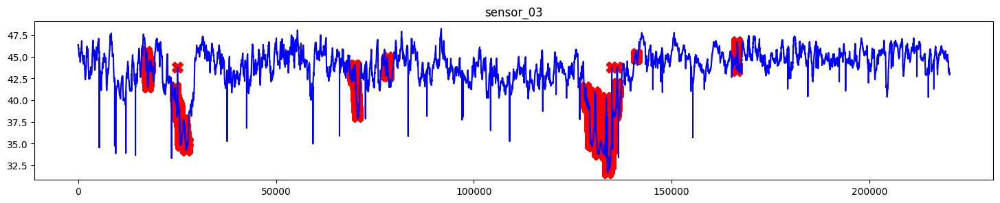

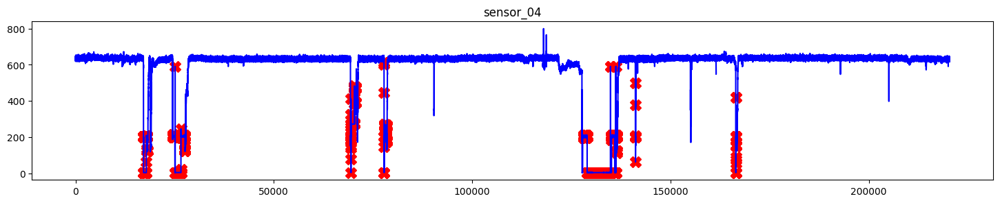

...

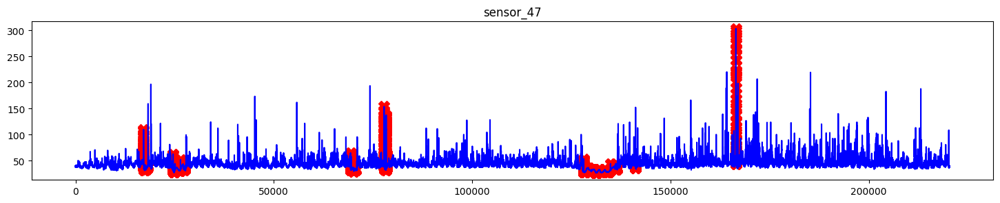

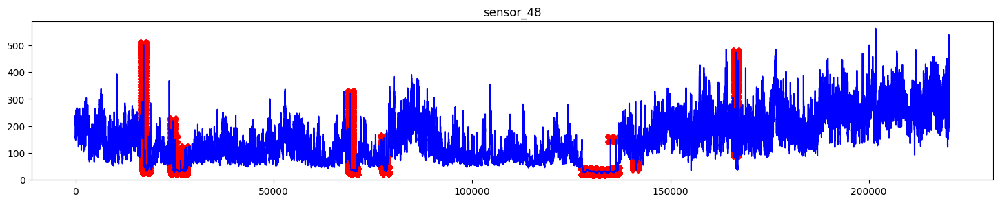

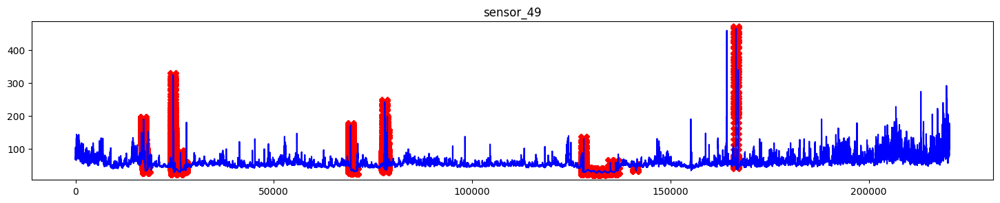

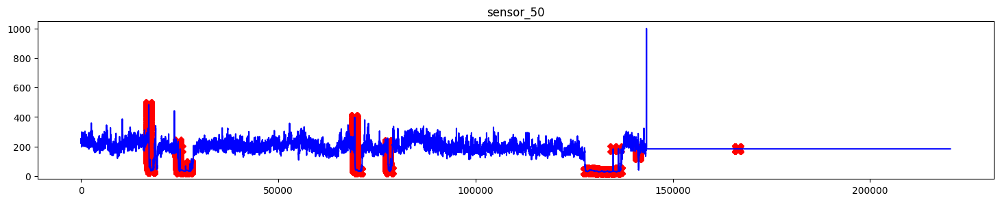

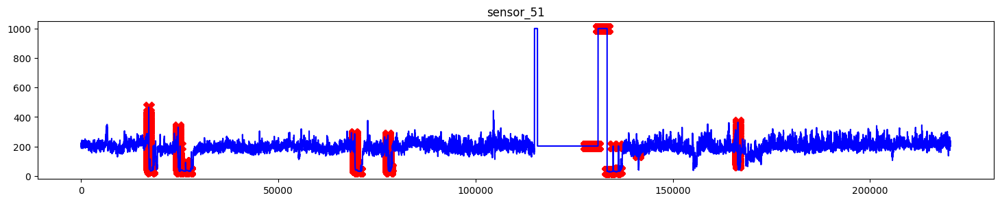

In [14]:

# Esta aproximación a la visualización sería con datos balanceados (o intento de)
broken_rec = df[df['machine_status'] !=  'NORMAL' ]

# Extraemos columnas numéricas solo, es decir quitamos machine_status y date
df2 = df.drop(['machine_status'], axis=1)
df2 = df2.drop(columns='date')
names=df2.columns

# Ploteamos series de tiempo para cada sensor con estado BROKEN o RECOVERING marcado con una X en rojo

for name in names:
    plt.figure(figsize=(18,3))
    plt.plot(broken_rec[name], linestyle='none', marker='X', color='red', markersize=12)
    plt.plot(df[name], color='blue')
    plt.title(name)
    plt.show()

In [ ]:
def calculate_statistics(data):
    """ Calcula estadísticas de las lecturas de los sensores: media, desviación estándar, mediana y rango. """
    # Calcula media, desviación estándar y mediana
    means = data.mean(axis=0)
    std_devs = data.std(axis=0)
    medians = data.median(axis=0)

    # Calcula el rango (max - min)
    ranges = data.max(axis=0) - data.min(axis=0)

    return means, std_devs, medians, ranges

# 'numeric_normal', 'numeric_broken', 'numeric_recovering' son DataFrame pre-filtrados sin 'machine_status'
numeric_normal = normal.drop('machine_status', axis=1)
numeric_broken = broken.drop('machine_status', axis=1)
numeric_recovering = recovering.drop('machine_status', axis=1)

# Se calculan las estadísticas para cada estado operacional
stats_normal = calculate_statistics(numeric_normal)
stats_broken = calculate_statistics(numeric_broken)
stats_recovering = calculate_statistics(numeric_recovering)

# Se imprimen los resultados
states = ['NORMAL', 'ROTO', 'RECUPERÁNDOSE']
for i, stats in enumerate([stats_normal, stats_broken, stats_recovering]):
    print(f"Estado {states[i]}:")
    print("Media:\n", stats[0])
    print("Desviación Estándar:\n", stats[1])
    print("Mediana:\n", stats[2])
    print("Rango:\n", stats[3], "\n")

Estado NORMAL:
Media:
 sensor_00                         0.949571
sensor_01                          0.84931
sensor_02                         0.807807
sensor_03                         0.755519
sensor_04                         0.781324
sensor_05                         0.753897
sensor_06                         0.622871
sensor_07                         0.685095
sensor_08                         0.635245
sensor_09                         0.603466
sensor_10                         0.581665
sensor_11                         0.746162
sensor_12                         0.692716
sensor_13                         0.242812
sensor_14                         0.730762
sensor_16                         0.558968
sensor_17                         0.697618
sensor_18                         0.470002
sensor_19                         0.666922
sensor_20                         0.798496
sensor_21                         0.687374
sensor_22                         0.768503
sensor_23                      

TODO - Plotear medianas, los ranges tmb


Se intenta buscar la correlación de los datos (en este caso utilizando el dataset original)

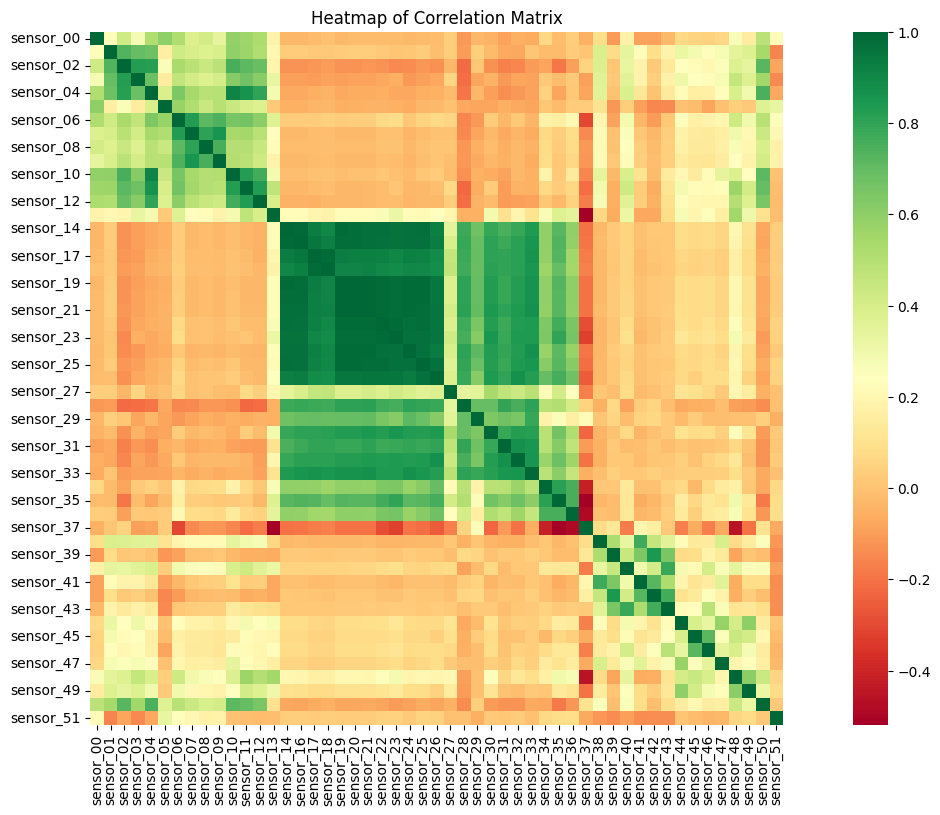

In [15]:
df_aux = df.select_dtypes(include=[np.number])
correlation_matrix = df_aux.corr()

# Let's see a heatmap for correlation
_ = plt.figure(figsize=(18,9))
sns.heatmap(correlation_matrix, square=True, cmap='RdYlGn')
plt.title('Heatmap of Correlation Matrix')
plt.show()

### Reduciendo dimensiones

Por el gran número de datos y variables que se presentan e intentando detectar patrones o relaciones se procederá a reducir la dimensionalidad en 2 componentes principales, para facilitar la visualización y comprensión de la estructura de los datos y mejorar el rendimiento de los algoritmos.

En este caso se procede a reducir los datos en dos componentes principales: 'pc1' y 'pc2' siendo estos variables sintéticas creadas a partir de los sensores originales.

El primer compomponente principal o 'pc1' sería la combinación lineal de las variables originales alineada con la mayor varianza de los datos. Principalmente lo que intenta es entender la mayor fuente de variabilidad en los datos.

En cuanto al segundo componente principal sería la dirección que camptura la segunda mayor variabilidad siendo independiente a pc1. Lo que se busca es proporcionar la información no presente en pc1

In [16]:
from sklearn.decomposition import PCA
features=['sensor_00', 'sensor_01', 'sensor_02', 'sensor_03', 'sensor_04',
       'sensor_05', 'sensor_06', 'sensor_07', 'sensor_08', 'sensor_09',
       'sensor_10', 'sensor_11', 'sensor_12', 'sensor_13', 'sensor_14',
       'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20',
       'sensor_21', 'sensor_22', 'sensor_23', 'sensor_24', 'sensor_25',
       'sensor_26', 'sensor_27', 'sensor_28', 'sensor_29', 'sensor_30',
       'sensor_31', 'sensor_32', 'sensor_33', 'sensor_34', 'sensor_35',
       'sensor_36', 'sensor_37', 'sensor_38', 'sensor_39', 'sensor_40',
       'sensor_41', 'sensor_42', 'sensor_43', 'sensor_44', 'sensor_45',
       'sensor_46', 'sensor_47', 'sensor_48', 'sensor_49', 'sensor_50',
       'sensor_51']

# Estandarización de los datos antes de aplicar PCA
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x)

# Se aplica PCA reduciendo a dos componentes principales
pca = PCA(n_components=2)
x = df_scaled.loc[:, features].values
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc1', 'pc2'])
finalDf = pd.concat([principalDf, df_scaled[['machine_status']]], axis = 1)


finalDf.head()

,pc1,pc2,machine_status
0,-0.006837,-0.002113,NORMAL
1,-0.006837,-0.002113,NORMAL
2,-0.018820,-0.008814,NORMAL
3,-0.009916,-0.005489,NORMAL
4,-0.011873,-0.016353,NORMAL


In [14]:
finalDf.describe().T

,count,mean,std,min,25%,50%,75%,max
pc1,220320.0,-9.081737e-17,0.859420,-1.003946,-0.407218,-0.332005,-0.077947,2.652996
pc2,220320.0,1.320980e-16,0.471022,-0.667198,-0.292656,-0.063495,0.053741,2.071462


# Detección de anomalías

## Métodos no incrementales

### Rango Intercuartil

En esta práctica, se utiliza el IQR para detectar outliers o valores atípicos, esto se realiza calculando el IQR para los componentes principales obtenidos a través del PCA, combinaciones lineales de las variables originales y que representan nuevas dimensiones al capturar la mayor parte de la variabilidad de los datos.

Los límites para determinar los outliers se establecen a 1.5 veces el IQR por debajo del Q1 y por encima del Q3, cualquier punto de dato que caiga fuera es un outlier.

El uso del IQR se considera útil en este contexto porque es menos susceptible a los extremos que otras medidas, como la desviación estándar. Siendo esto crítico en la práctica porque en los datos industriales, los outliers pueden indicar errores de medición, defectos en el equipo, o condiciones operativas anormales que son vitales para la toma de decisiones correctivas.

Identificar correctamente estos outliers puede ayudar a prevenir fallos, optimizar operaciones y garantizar calidad y seguridad en distintos procesos.

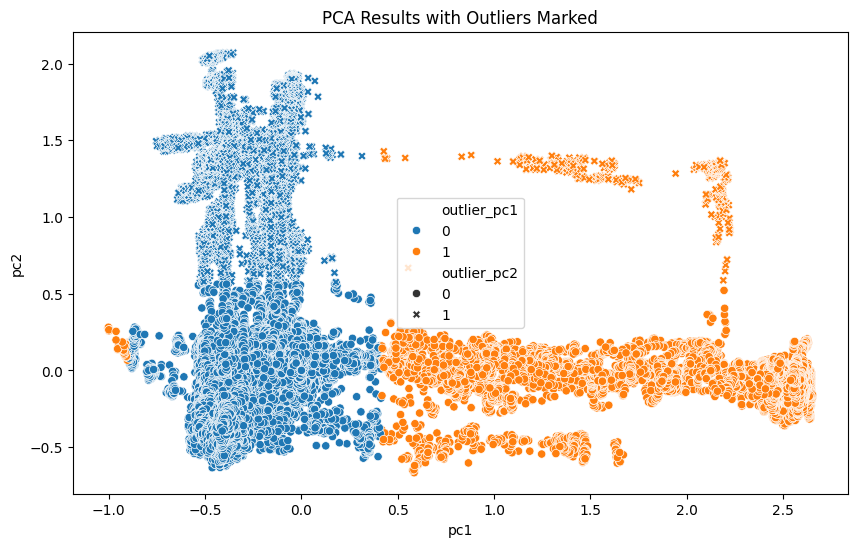

In [17]:
def calculate_iqr(data, column_name):
    '''
        Cálculo del IQR para cada componente principal
    '''
    q1 = data[column_name].quantile(0.25)
    q3 = data[column_name].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    return lower_bound, upper_bound

lower_pc1, upper_pc1 = calculate_iqr(finalDf, 'pc1')
lower_pc2, upper_pc2 = calculate_iqr(finalDf, 'pc2')

# Identificación de outliers basados en IQR
finalDf['outlier_pc1'] = ((finalDf['pc1'] < lower_pc1) | (finalDf['pc1'] > upper_pc1)).astype(int)
finalDf['outlier_pc2'] = ((finalDf['pc2'] < lower_pc2) | (finalDf['pc2'] > upper_pc2)).astype(int)

# Visualización de resultados
plt.figure(figsize=(10, 6))
sns.scatterplot(x='pc1', y='pc2', hue='outlier_pc1', style=finalDf['outlier_pc2'], data=finalDf)
plt.title('PCA Results with Outliers Marked')
plt.show()

En el anterior gráfico podemos observar la distribución en el espacio bidimensional de los dos componentes principales. La mayoría de datos se muestran en el rango [-0.5, 0] a [2.5, 0]. Se podría sugerir que el pc1 podría capturar la mayor variación en los datos.

Los valores que no son outliers para pc1 o pc2 se marcan en azul y negro respectivamente, mientras que los outliers para pc1 o pc2 se marcan en naranja y con un símbolo "x" respectivamente. 

Efectivamente se puede comprobar varios puntos como outliers, alejados del rango previamente observado, siendo más notable el número de outliers de pc1.


A continuación se plantea otro método para realizarlo se haría el cálculo del IQR y la determinación de los valores atípicos

In [18]:
# Calcular IQR para el primer componente principal (pc1)
q1_pc1, q3_pc1 = finalDf['pc1'].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1

# Calcular límites superior e inferior para valores atípicos en pc1
lower_pc1 = q1_pc1 - (1.5 * iqr_pc1)
upper_pc1 = q3_pc1 + (1.5 * iqr_pc1)

# Filtrar los valores atípicos de pc1
finalDf['anomaly_pc1'] = ((finalDf['pc1'] > upper_pc1) | (finalDf['pc1'] < lower_pc1)).astype(int)

# Calcular IQR para el segundo componente principal (pc2)
q1_pc2, q3_pc2 = finalDf['pc2'].quantile([0.25, 0.75])
iqr_pc2 = q3_pc2 - q1_pc2
lower_pc2 = q1_pc2 - (1.5 * iqr_pc2)
upper_pc2 = q3_pc2 + (1.5 * iqr_pc2)

# Filtrar los valores atípicos de pc2
finalDf['anomaly_pc2'] = ((finalDf['pc2'] > upper_pc2) | (finalDf['pc2'] < lower_pc2)).astype(int)

In [19]:
print(df.columns)  # Verificar columnas en el DataFrame original
print(finalDf.columns)  # Verificar columnas en el DataFrame final después de PCA y otras transformaciones

Index(['sensor_00', 'sensor_01', 'sensor_02', 'sensor_03', 'sensor_04',
       'sensor_05', 'sensor_06', 'sensor_07', 'sensor_08', 'sensor_09',
       'sensor_10', 'sensor_11', 'sensor_12', 'sensor_13', 'sensor_14',
       'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20',
       'sensor_21', 'sensor_22', 'sensor_23', 'sensor_24', 'sensor_25',
       'sensor_26', 'sensor_27', 'sensor_28', 'sensor_29', 'sensor_30',
       'sensor_31', 'sensor_32', 'sensor_33', 'sensor_34', 'sensor_35',
       'sensor_36', 'sensor_37', 'sensor_38', 'sensor_39', 'sensor_40',
       'sensor_41', 'sensor_42', 'sensor_43', 'sensor_44', 'sensor_45',
       'sensor_46', 'sensor_47', 'sensor_48', 'sensor_49', 'sensor_50',
       'sensor_51', 'machine_status', 'date'],
      dtype='object')
Index(['pc1', 'pc2', 'machine_status', 'outlier_pc1', 'outlier_pc2',
       'anomaly_pc1', 'anomaly_pc2'],
      dtype='object')


Detectando anomalías en el sensor 11

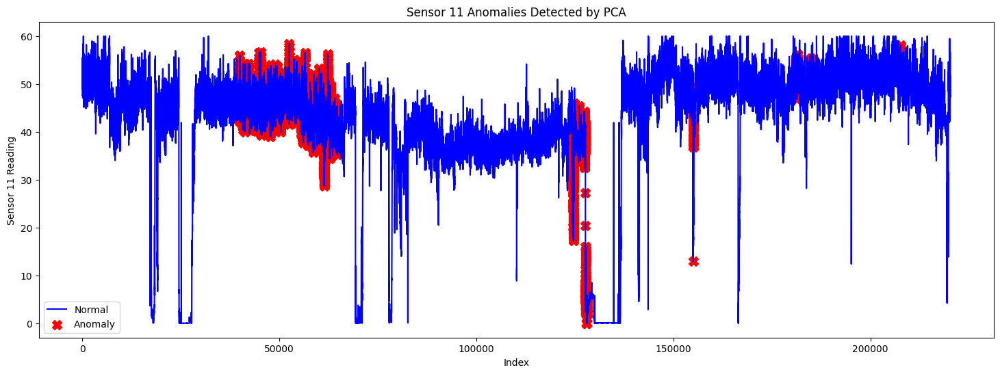

In [20]:
import matplotlib.pyplot as plt

# Se filtran las anomalías en pc1 utilizando finalDf
anomalias = finalDf[finalDf['anomaly_pc1'] == 1]

# ploteamos valores de sensor_11 del DataFrame df
plt.figure(figsize=(18, 6))
plt.plot(df['sensor_11'], color='blue', label='Normal')

# Las anomalías quedan marcadas en rojo
plt.scatter(anomalias.index, df.loc[anomalias.index, 'sensor_11'], color='red', marker='X', s=100, label='Anomaly')

plt.xlabel('Index')
plt.ylabel('Sensor 11 Reading')
plt.title('Sensor 11 Anomalies Detected by PCA')
plt.legend()
plt.show()

In [19]:
def outlier_treatment(datacolumn):
    sorted_data = np.sort(datacolumn)
    Q1, Q3 = np.percentile(sorted_data, [25, 75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5 * IQR)
    upper_range = Q3 + (1.5 * IQR)
    return lower_range, upper_range

# Ejemplo de uso para pc1
lowerbound, upperbound = outlier_treatment(finalDf['pc1'])

### K-Means Clustering

El uso del algoritmo K-Means Clustering en esta práctica tiene como objetivo segmentar las lecturas de los sensores en grupos o clústeres basados en similitudes en sus características.

Esta técnica de aprendizaje no supervisado agrupa los datos en un número predefinido de clústeres, en este caso basado en las principales componentes analizadas del conjunto de datos, reduciendo la complejidad y resaltando patrones subyacentes en el comportamiento de los sensores.

Al asignar cada lectura de sensor a un clúster, podemos identificar qué conjunto de datos comparte características comunes y cómo se diferencian de otros grupos.

Esto es especialmente útil para detectar condiciones operativas inusuales o para segmentar las condiciones de funcionamiento de la maquinaria, permitiendo así intervenciones más dirigidas y optimización en el mantenimiento y la operación de los equipos.

K-Means proporciona una forma clara y visual de comprender la agrupación de los datos y es útil para la toma de decisiones en entornos industriales donde se manejan grandes volúmenes de datos de sensores.

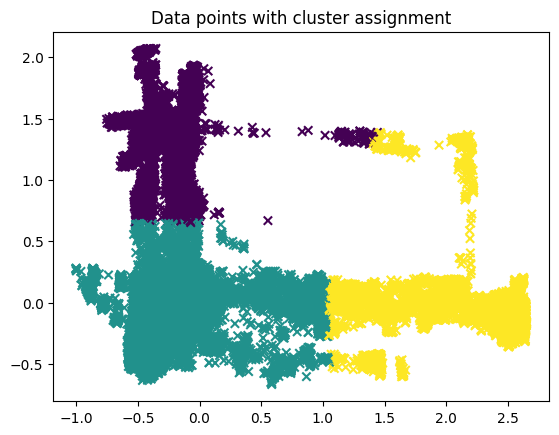

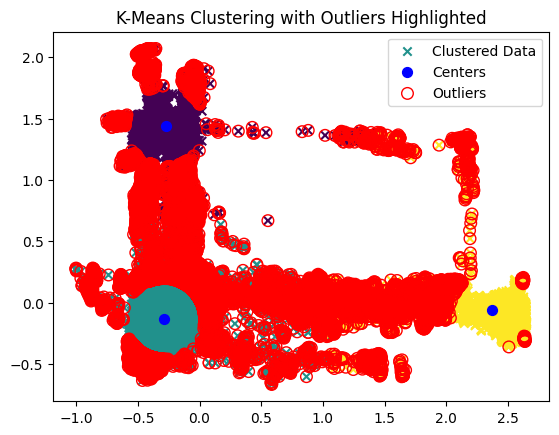

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist

# Utilizando 'pc1' y 'pc2' de finalDf para el clustering
data = finalDf[['pc1', 'pc2']].values  

# KMeans model, setting k = 3
km = KMeans(n_clusters=3)
clusters = km.fit_predict(data)

# Plotting dataset
plt.scatter(data[:, 0], data[:, 1], c=clusters, marker='x')
plt.title("Data points with cluster assignment")

# Obtaining the centers of the clusters
centroids = km.cluster_centers_

# Calculating distances from each point to its cluster center
distances = []
points = []

for i, center_elem in enumerate(centroids):
    # cdist is used to calculate the distance between center and other points
    cluster_points = data[clusters == i]
    cluster_distances = cdist([center_elem], cluster_points, 'euclidean')[0]
    distances.extend(cluster_distances)
    points.extend(cluster_points)

# Converting lists to numpy arrays for indexing
points = np.array(points)
distances = np.array(distances)

# Identifying outliers as those beyond the 80th percentile of distances
percentile = 80
threshold = np.percentile(distances, percentile)
outliers = points[distances > threshold]

# Plotting
fig, ax = plt.subplots()
ax.scatter(data[:, 0], data[:, 1], c=clusters, marker='x', label='Clustered Data')
ax.scatter(*zip(*centroids), marker='o', facecolor='b', edgecolor='b', s=50, label='Centers')
ax.scatter(*zip(*outliers), marker='o', facecolor='None', edgecolor='r', s=70, label='Outliers')
plt.title("K-Means Clustering with Outliers Highlighted")
plt.legend()
plt.show()


Asignación de Clústeres a los Datos:

En la primera gráfica:

Se muestra la distribución de los datos en el espacio de características (en este caso, dos dimensiones).
Cada punto es una observación (o un registro) de los datos.
Los puntos están coloreados según el clúster al que han sido asignados por el algoritmo de K-Means. Esto se hace usando un modelo que divide el conjunto de datos en k grupos (donde k es el número de clústeres que se definió, en este caso 3) minimizando la varianza dentro de cada grupo.
Las marcas en forma de 'x' representan los puntos de datos y su color indica a qué clúster pertenecen según el algoritmo.

Visualización de Centros y Detección de Anomalías:

En la segunda gráfica:
Además de mostrar los puntos de datos con sus respectivos clústeres, se resaltan los centros de cada clúster con un marcador en forma de círculo ('o') lleno de color azul. Estos centros son los puntos promedio de cada clúster y representan el "centroide", es decir, el corazón de cada grupo.

Además, se identifican los outliers o anomalías en la gráfica. Estos se muestran con círculos vacíos de borde rojo y son más grandes que los puntos de datos normales. Estos outliers son puntos de datos que están a una distancia considerable de sus centros de clúster respectivos. Para identificarlos, se utiliza un cálculo de distancias desde cada punto hasta su centroide y se consideran como outliers aquellos que están más allá del percentil 80 de estas distancias.
Estos outliers pueden ser de especial interés ya que podrían indicar errores de medición, eventos raros o condiciones anormales que podrían requerir una investigación adicional.

### Isolation Forest

Se está utilizando el método Isolation Forest para identificar anomalías o comportamientos atípicos en los datos recopilados de sensores en una máquina.

Es un modelo particularmente efectivo para detectar outliers porque funciona bajo el principio de que las anomalías son pocas y diferentes en sus características en comparación con los valores normales.

Al establecer un 13% de contaminación, asumimos que aproximadamente el 13% de los datos son anómalos. Esta técnica es útil en escenarios industriales para prevenir fallos, optimizar operaciones y garantizar la seguridad al alertar sobre lecturas inusuales que podrían indicar un problema potencial.

Al aplicar Isolation Forest a las componentes principales obtenidas del análisis PCA, buscamos simplificar la dimensionalidad de los datos conservando solo las características más significativas, facilitando así una detección de anomalías más efectiva y eficiente

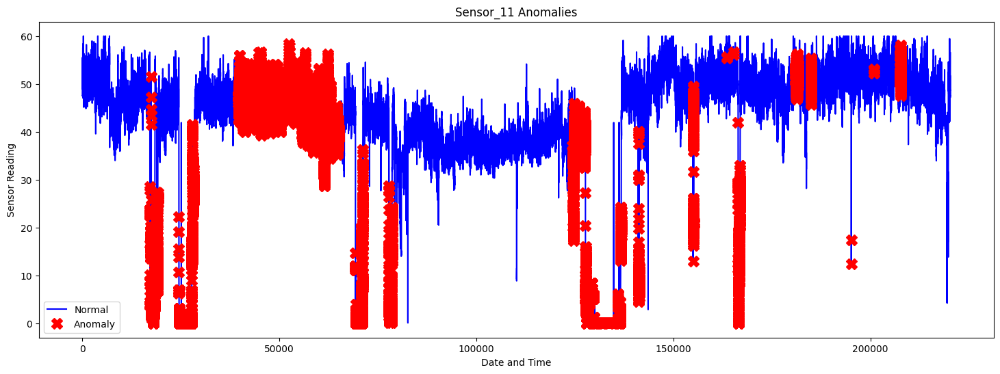

In [22]:
from sklearn.ensemble import IsolationForest
import pandas as pd
import matplotlib.pyplot as plt

data = finalDf[['pc1', 'pc2']].values

# Se configura un factor de contaminación del 13%.

outliers_fraction = 0.13
model = IsolationForest(contamination=outliers_fraction)
model.fit(data)

# Los resultados del modelo se integran en finalDf y luego se transfieren a df para la visualización
finalDf['anomaly2'] = pd.Series(model.predict(data), index=finalDf.index)

# Se añaden las anomalías
df['anomaly2'] = finalDf['anomaly2']

# Filtrado de anomalías
anomalies = df[df['anomaly2'] == -1]  # anomaly

# Visualización del Sensor 11
plt.figure(figsize=(18,6))
plt.plot(df['sensor_11'], color='blue', label='Normal')
plt.plot(anomalies['sensor_11'], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
plt.xlabel('Date and Time')
plt.ylabel('Sensor Reading')
plt.title('Sensor_11 Anomalies')
plt.legend(loc='best')
plt.show()


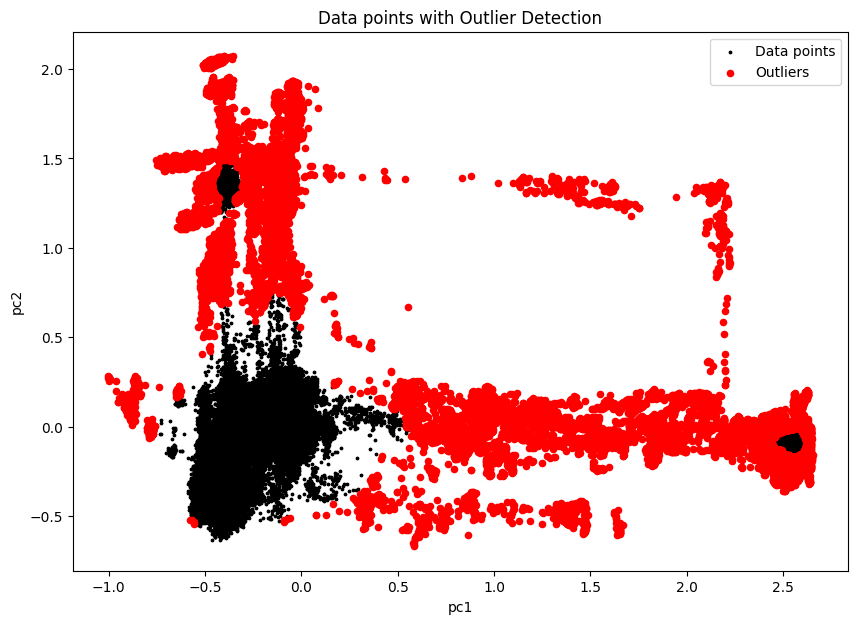

In [23]:
# Visualización del gráfico con los puntos de datos y los outliers marcados.
plt.figure(figsize=(10, 7))
plt.scatter(finalDf['pc1'], finalDf['pc2'], c='k', s=3, label='Data points')
outliers = finalDf.loc[finalDf['anomaly2'] == -1]
plt.scatter(outliers['pc1'], outliers['pc2'], c='red', s=20, label='Outliers')
plt.title('Data points with Outlier Detection')
plt.xlabel('pc1')
plt.ylabel('pc2')
plt.legend()
plt.show()

En la anterior gráfica se puede observar un grupo concentrado de datos en un rango determinado, alrededor del origen de pc1 y pc2. También se observan la agrupaciones de outliers en distintas secciones, pudiendo indicar que hay patrones específicos no considerados. Podrían llegar a mostrar comportamientos inusuales.



### Comparativa de resultados no incrementales

El Isolation Forest es particularmente sensible y versátil en la identificación de outliers, porque se limita a detectar solo los más extremos sino que también capta aquellos que difieren de manera más sutil del grueso de los datos. Se ha podido comprobar que identifica la mayor cantidad de outliers en comparación con los otros métodos.

Esta capacidad para identificar tanto anomalías individuales como patrones atípicos colectivos lo hace adecuado para una amplia gama de situaciones, incluyendo entornos con datos complejos y multidimensionales. A diferencia del IQR, que señala outliers basándose en una desviación estadística de la norma y podría no capturar anomalías dentro de un espectro más amplio de variación de datos, el Isolation Forest puede discernir irregularidades incluso en la presencia de estructuras subyacentes complejas.

Por otro lado, el algoritmo de K-Means, aunque no está diseñado específicamente para la detección de outliers, puede proporcionar cierta perspectiva sobre los puntos de datos que no se ajustan bien a ningún cluster definido. Los outliers utilizando este método llegan a aparecer dentro de los clusters, pudiendo visualizar así puntos significativamente distintos de otros compañeros del propio cluster.

Su eficacia puede verse comprometida si los outliers están situados cerca de los bordes de los clusters, ya que pueden ser erróneamente considerados como parte de un cluster. Además, la configuración del número de clusters (tres en este caso) tiene un impacto significativo en la identificación de outliers. 


A diferencia de Isolation Forest y K-Means, el método IQR adopta un enfoque más convencional, identificando como outliers los puntos que caen fuera de los límites calculados a partir de los cuartiles de los datos. Puede considerarse no ser tan efectivo en escenarios con datos que presentan una gran cantidad de subgrupos o complejidad intrínseca.

En este caso se identifican los outliers en las periferias del gráfico, lo que demuestra que este método se centra en la escala de los datos y que no puede representar igual de bien los subgrupos como otros de los métodos utilizados.

## Métodos incrementales (WIP)

Primero se importan las librerías de river necesarias.

In [24]:
from river import anomaly
from river import compose
from river import preprocessing
from river import stream
from river import cluster

### K means Incremental

El enfoque incremental de K-means es una adaptación del algoritmo de agrupamiento K-means diseñado para entornos donde los datos se actualizan con frecuencia.

En lugar de reiniciar completamente el algoritmo K-means cada vez que se añaden nuevos datos, el método incremental ajusta los centros de los clústeres existentes para incorporar la nueva información. Esto se realiza recalculando los centros de los clústeres mediante un promedio ponderado que incluye los nuevos datos. Este proceso no solo evita la necesidad de una recalculación completa, sino que también es especialmente beneficioso para grandes bases de datos multidimensionales, donde una ejecución completa sería demasiado costosa en términos de recursos computacionales.

Además, el K-means incremental mide cuánto cambian los centros de los clústeres con la adición de nuevos puntos y puede establecerse un umbral de cambio (
δ), que determina hasta qué punto los centros pueden cambiar antes de que sea necesaria una reevaluación total del modelo. Esta característica lo hace particularmente útil en aplicaciones dinámicas donde los datos cambian constantemente, permitiendo un ajuste continuo y eficiente de los clústeres sin la carga de recalcular todo desde cero cada vez.

Observación {'pc1': -0.006836818572224274, 'pc2': -0.0021133853421362483} asignada al cluster: 0
Observación {'pc1': -0.006836818572260262, 'pc2': -0.0021133853421678576} asignada al cluster: 0
Observación {'pc1': -0.018820101371842677, 'pc2': -0.008813528562447047} asignada al cluster: 0
Observación {'pc1': -0.009915800866437039, 'pc2': -0.005488798665141837} asignada al cluster: 0
Observación {'pc1': -0.011873126582584636, 'pc2': -0.016352822998318604} asignada al cluster: 0
Observación {'pc1': -0.0006916926806811785, 'pc2': -0.03875121125260767} asignada al cluster: 0
Observación {'pc1': -0.021857372189396675, 'pc2': -0.02975604387235653} asignada al cluster: 0
Observación {'pc1': -0.0018061016381613528, 'pc2': -0.025787056431446964} asignada al cluster: 0
Observación {'pc1': -0.010960923020489356, 'pc2': -0.033869154116456024} asignada al cluster: 0
Observación {'pc1': -0.012560655730481192, 'pc2': -0.035433125707497314} asignada al cluster: 0
Observación {'pc1': -0.003730742775505

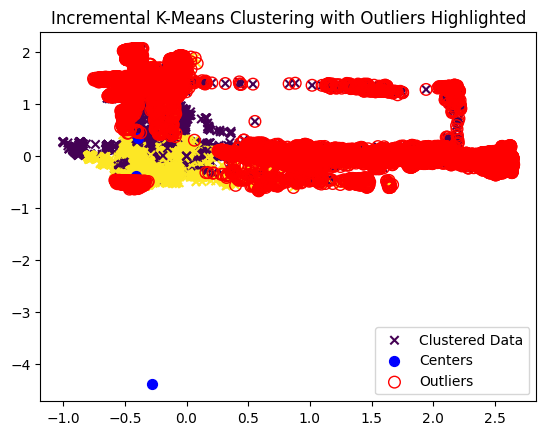

In [34]:
data = finalDf[['pc1', 'pc2']]

data_stream = stream.iter_pandas(data)

# Configuración del modelo de K-Means Incremental
k_means = cluster.KMeans(n_clusters=3, halflife=0.4, sigma=3, mu=0.1, seed=42)

points = []  # Almacenar los puntos para el plot
labels = []  # Almacenar las etiquetas de los clusters
distances = []  # Almacenar las distancias para manejar el umbral


# Procesar el stream de datos
for dato, _ in data_stream:
    k_means.learn_one(dato)  # Actualizar el modelo con cada muestra
    label = k_means.predict_one(dato)
    pred = k_means.predict_one(dato)  # Predecir el clúster para cada punto de datos
    points.append([dato['pc1'], dato['pc2']])
    labels.append(label)
    print(f"Observación {dato} asignada al cluster: {pred}")

# Convertir a NumPy arrays para facilitar el manejo
points = np.array(points)
labels = np.array(labels)
centers = np.array([list(center.values()) for center in k_means.centers.values()])

# Calculando las distancias desde cada punto a su centro de clúster
for point, label in zip(points, labels):
    centroid = centers[label]
    distance = np.linalg.norm(point - centroid)
    distances.append(distance)

# Identificando outliers como aquellos más allá del percentil 80 de distancias
percentile = 80
threshold = np.percentile(distances, percentile)
outliers = points[np.array(distances) > threshold]


# Plotting
plt.scatter(points[:, 0], points[:, 1], c=labels, marker='x', label='Clustered Data')
plt.scatter(centers[:, 0], centers[:, 1], marker='o', facecolor='b', edgecolor='b', s=50, label='Centers')
plt.scatter(outliers[:, 0], outliers[:, 1], marker='o', facecolor='None', edgecolor='r', s=70, label='Outliers')
plt.title("Incremental K-Means Clustering with Outliers Highlighted")
plt.legend()
plt.show()

El número de clústers que mejor valor otorga es 2.

Los puntos rojos, que sobresalen del patrón general de los datos, son los marcados como outliers debido a su posición atípica en el espacio de características, sugiriendo que estos puntos son anómalos y no encajan bien con el resto. Los amarillos y morados representan los datos que han sido agrupados con éxito en clústeres, normalmente alrededor de un centroide, indicado por los puntos azules.

Una vez establecidos los centroides, la detección de outliers se basa típicamente en la distancia de los puntos de datos a su centroide más cercano. Puntos que están a una distancia mayor que un umbral establecido se consideran outliers. Este umbral es difícil de definir y se suele determinar mediante experimentación. No hay una fórmula única para fijar este umbral, ya que depende de la distribución de los datos y del contexto específico en el que se aplique el modelo.

El umbral que determina los outliers ha sido fijado a un 80, a pesar de ser un valor relativamente alto podemos observar que en la gráfica quedan identificados un gran número de outliers. 
Esto es adecuado para un escenario donde es crítico no perderse ninguna anomalía potencial, pero podría ser demasiado sensible en otro contexto donde se prefiere minimizar las falsas alarmas.

Se identifican diversos "centers" uno de ellos entre el rango [-0.5, 0.0] y otros en torno al origen del gráfico.

Vamos a crear ahora otro gráfico, con intención de que resulte más sencilla su comparativa con el siguiente modelo.

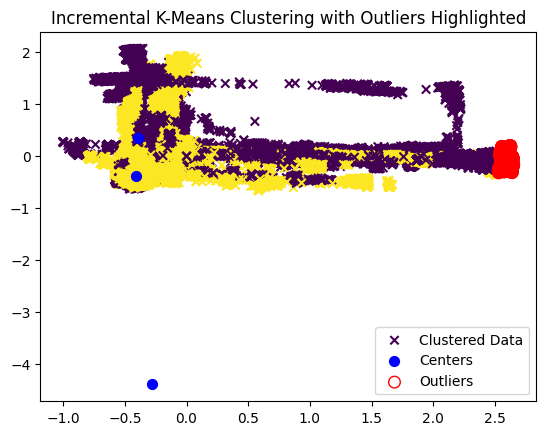

In [35]:
# Identificando outliers como aquellos más allá del percentil 95 de distancias
percentile = 95
threshold = np.percentile(distances, percentile)
outliers = points[np.array(distances) > threshold]


# Plotting
plt.scatter(points[:, 0], points[:, 1], c=labels, marker='x', label='Clustered Data')
plt.scatter(centers[:, 0], centers[:, 1], marker='o', facecolor='b', edgecolor='b', s=50, label='Centers')
plt.scatter(outliers[:, 0], outliers[:, 1], marker='o', facecolor='None', edgecolor='r', s=70, label='Outliers')
plt.title("Incremental K-Means Clustering with Outliers Highlighted")
plt.legend()
plt.show()

### Half Space Tree

Los Half-Space Trees son una variante online de los Isolation Forest, diseñados para la detección de anomalías en flujos de datos continuos. Estos árboles funcionan dividiendo recursivamente el espacio de datos en hiperespacios más pequeños a través de cada nodo, seleccionando un valor umbral aleatorio para una dimensión elegida al azar.

Este proceso se repite hasta alcanzar una profundidad predeterminada o hasta manejar suficientes datos. En la detección de anomalías, los nuevos puntos de datos se evalúan pasándolos a través de los árboles hasta llegar a un nodo hoja, donde la densidad de puntos en ese nodo indica la posibilidad de una anomalía.

Los nodos con puntuaciones altas indican anomalías miesntras que aquellos con puntuaciones bajas indican un funcionamiento normal.

Los Half-Space Trees son especialmente efectivos cuando las anomalías están dispersas a través del espacio de características, ya que las regiones de baja densidad se identifican fácilmente con las particiones recursivas.

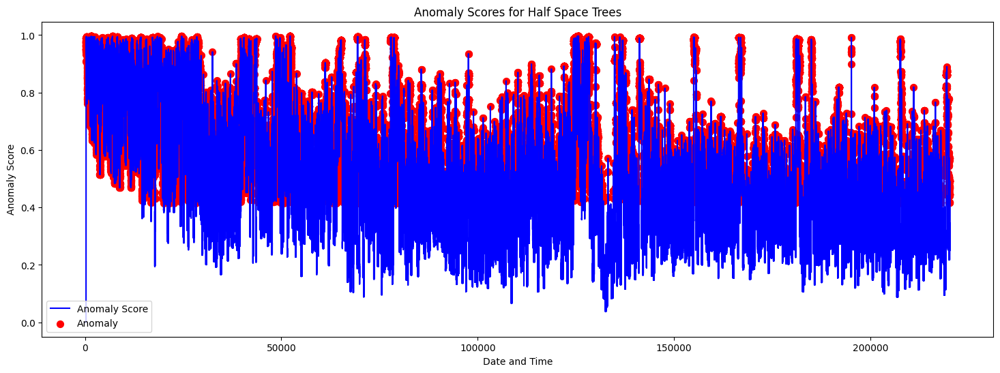

In [26]:
# Prepara un stream con los datos que impactarán el modelo de anomalías
data_stream = stream.iter_pandas(finalDf[['pc1', 'pc2']])

# Configura el modelo de Half-Space Trees con preprocesamiento
modelHST = compose.Pipeline(
    preprocessing.MinMaxScaler(),  # Escala los datos entre 0 y 1
    anomaly.HalfSpaceTrees(seed=42)  # Configuración del detector de anomalías
)

# Procesa cada punto en el stream de datos y calcula los scores de anomalía
scores = []
for dato, _ in data_stream:
    modelHST.learn_one(dato)  # Actualiza el modelo con el dato actual
    score = modelHST.score_one(dato)  # Obtiene el score de anomalía
    scores.append(score)

# Añade los scores y etiquetas de anomalía en finalDf
finalDf['anomaly_score'] = scores
finalDf['is_anomaly'] = finalDf['anomaly_score'] > np.percentile(scores, 50)

# Transferencia segura de datos a df
if 'anomaly_score' not in df.columns:
    df['anomaly_score'] = finalDf['anomaly_score']
    df['is_anomaly'] = finalDf['is_anomaly']

# Filtra las anomalías
anomalies = df[df['is_anomaly']]

# Verifica si 'anomaly_score' existe en df antes de trazar
if 'anomaly_score' in df.columns:
    # Visualiza los resultados con los scores de anomalía
    plt.figure(figsize=(18, 6))
    plt.plot(df.index, df['anomaly_score'], label='Anomaly Score', color='blue')
    plt.scatter(anomalies.index, anomalies['anomaly_score'], color='red', marker='o', s=50, label='Anomaly')
    plt.xlabel('Date and Time')
    plt.ylabel('Anomaly Score')
    plt.title('Anomaly Scores for Half Space Trees')
    plt.legend(loc='lower left')
    plt.show()

En este caso el gráfico está mostrando los scores de anomalía. La visualización principal es el gráfico que representa los scores de anomalía calculados para cada punto a lo largo del tiempo. El eje X en este caso indica la fecha y hora específica y el eje Y es la magnitud del score de anomalía calculado por el modelo.

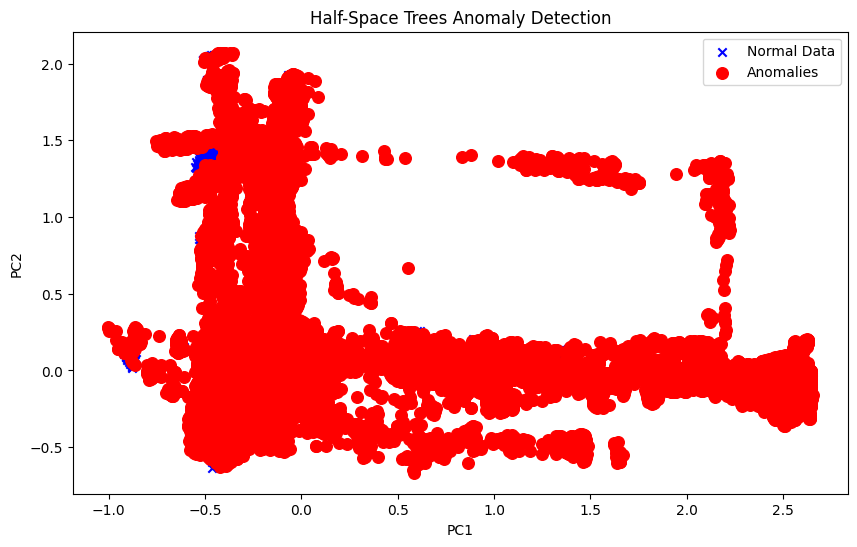

In [29]:
normal_points = finalDf[finalDf['is_anomaly'] == False][['pc1', 'pc2']].values
anomaly_points = finalDf[finalDf['is_anomaly'] == True][['pc1', 'pc2']].values

# Visualización
plt.figure(figsize=(10, 6))

# Plotea los puntos normales
plt.scatter(normal_points[:, 0], normal_points[:, 1], color='blue', marker='x', label='Normal Data')

# Plotea las anomalías con diferente color
plt.scatter(anomaly_points[:, 0], anomaly_points[:, 1], color='red', marker='o', edgecolor='r', s=70, label='Anomalies')

plt.title('Half-Space Trees Anomaly Detection')
plt.xlabel('PC1')  
plt.ylabel('PC2')  
plt.legend()
plt.show()

Parece haber un pequeño grupo de los "normal data", estos puntos azules ubicados en la región central izquierda del gráfico, aproximadamente en el rango de -0.5 a 0 en el eje PC1 y de 0 a 0.5 en el eje PC2. También se pueden observar algunos puntos azules dispersos a lo largo de las áreas dominadas por puntos rojos, pero son bastante difíciles de identificar individualmente debido a la dominante presencia de anomalías.

Seguramente el modelo Half-Space Trees pueda estar sobreestimando las anomalías o que realmente sea así.




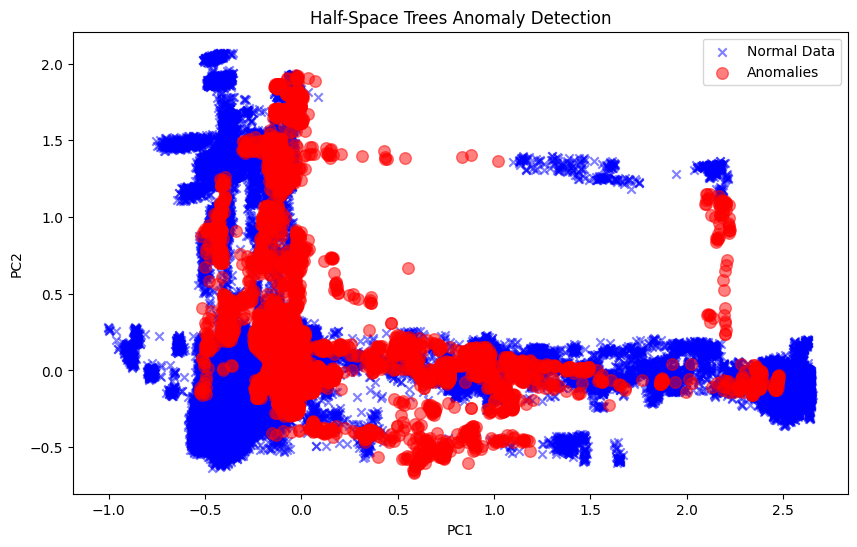

In [32]:
from river import anomaly, compose, preprocessing, stream
import matplotlib.pyplot as plt
import numpy as np

# Se prepara un stream de datos
data_stream = stream.iter_pandas(finalDf[['pc1', 'pc2']])

# Configurar el modelo de Half-Space Trees con preprocesamiento
modelHST = compose.Pipeline(
    preprocessing.StandardScaler(), 
    anomaly.HalfSpaceTrees(n_trees=25, height=15, seed=42) 
)

# Procesar cada punto en el stream de datos y calcular los scores de anomalía
scores = []
for dato, _ in data_stream:
    modelHST.learn_one(dato)  # Actualiza el modelo con el dato actual, no es necesario reasignar a modelHST
    score = modelHST.score_one(dato)  # Obtiene el score de anomalía
    scores.append(score)

# Define el umbral como un percentil más alto para reducir el número de falsos positivos
threshold = np.percentile(scores, 95)

finalDf['anomaly_score'] = scores
finalDf['is_anomaly'] = finalDf['anomaly_score'] > threshold

# Visualización
normal_points = finalDf[finalDf['is_anomaly'] == False][['pc1', 'pc2']].values
anomaly_points = finalDf[finalDf['is_anomaly'] == True][['pc1', 'pc2']].values

plt.figure(figsize=(10, 6))

plt.scatter(normal_points[:, 0], normal_points[:, 1], alpha=0.5, color='blue', marker='x', label='Normal Data')
plt.scatter(anomaly_points[:, 0], anomaly_points[:, 1], alpha=0.5, color='red', marker='o', edgecolor='r', s=70, label='Anomalies')

plt.title('Half-Space Trees Anomaly Detection')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

En este gráfico se observa una dispersión considerable de los datos normales, y se ve claramente cómo el modelo discrimina mejor entre puntos de datos normales y anomalías.

Las anomalías están agrupadas en secciones específicas pero se podría incluso llegar a ajustar el umbral para reducirlo todavía más. En este caso se suponen suficientemente significativas.

### Comparación de resultados incrementales

Comparando los dos gráficos que presentan los resultados del modelo de K-Means incremental y del modelo de Half-Space Trees, se pueden observar diferencias tanto en la distribución de los puntos como en la identificación de anomalías o outliers.

El método K-Means identifica una estructura mucho más definida gracias a los centros de clúster y los outliers claramente diferenciados mientras que el Half-Space Trees revela una separación menos definida, con más número de outliers.

Cada modelo difiere en su interpretación de los datos y de reaccionar a las propias variaciones del conjunto de datos, es decir tienen una sensibilidad distinta. 

Al tener un mayor número de outliers el modelo de Half Space Trees podríamos deducir que el modelo es más sensible a las desviaciones en los datos. Así mismo podríamos decir que se debe a la naturaleza del modelo, que se enfoca en la rareza de los puntos en relación con lo que es la estructura de los datos, en vez de su proximidad al centro de clúster como podemos ver en el K-Means.

Como conclusiones de estos modelos podemos decir que:

* El modelo de K-Means parece menos sensible a los puntos que se desvían de la media del clúster y más enfocado en la cohesión del clúster.
* El modelo de Half-Space Trees, al ser específicamente diseñado para detectar anomalías, es más sensible a las irregularidades o rarezas en el patrón de los datos.
* La misma configuración de umbral lleva a resultados diferentes debido a que los métodos calculan los scores de anomalía de manera distinta. K-Means utiliza la distancia a los centroides, mientras que Half-Space Trees utiliza un enfoque basado en árboles de decisión que pueden capturar diferentes aspectos de los datos.





## Comparación entre métodos incrementales y no incrementales

### Métodos No Incrementales:

En el método no incremental de K-Means, los centros de los clústeres se identifican después de considerar todo el conjunto de datos. Por lo tanto, el modelo puede optimizar la ubicación de los centros de los clústeres para minimizar la varianza dentro de cada clúster. Esto se refleja en los centros azules claramente definidos y los outliers rojos ubicados a una distancia significativa de estos centros.

En la visualización del método de detección de anomalías no incremental. La definición de qué es una anomalía parece ser menos estructurada que en el K-Means, ya que no hay clústeres visibles.

### Métodos Incrementales:

En los métodos incrementales, los modelos se actualizan con cada nueva observación en lugar de después de ver todos los datos. Esto puede resultar en centros de clústeres menos optimizados porque el modelo no tiene en cuenta todo el conjunto de datos desde el principio.

En el clustering incremental K-Means, los centros de clústeres pueden cambiar con cada nueva observación, lo que potencialmente podría llevar a una definición más dinámica de qué constituye un outlier. Esto puede resultar en una distribución de outliers diferente a la de los métodos no incrementales.

Para la detección de anomalías, un modelo incremental como los Half-Space Trees puede ajustarse en tiempo real, lo que es una ventaja para datos en streaming o grandes conjuntos de datos que no se pueden procesar de una sola vez. Esto podría llevar a una sensibilidad diferente en la detección de anomalías en comparación con los métodos no incrementales.


Los resultados son similares entre los distintos métodos. En el caso de los no incrementales suelen tener una visión global de todos los datos, lo que puede conducir a una representación más precisa de la estructura subyacente de los datos. Sin embargo, no son adecuados para datos en tiempo real o bases de datos muy grandes donde no es práctico o posible procesar todos los datos simultáneamente